# Galaxy Zoo - EDA

## Business case

The main objective of this project is to cluster galaxies that are visually similar and to test the hypothesis of the Galaxy morphological classification - it's a way to visually divide galaxies into groups and to see if the Hubble sequence emerges


In [1]:
import os
import sys
import warnings

sys.path.insert(0, os.path.abspath(os.path.join("..", "src")))
from eda import load_images, show_images, show_pixels, show_images_layers, get_binary_image, get_boxes
from preprocessing import preprocess_image, preprocess_image_2

import cv2
import numpy as np
import pandas as pd

import tensorflow as tf
from skimage import transform
from skimage.restoration import (
    denoise_bilateral,
    denoise_tv_chambolle,
    denoise_wavelet,
    estimate_sigma,
)
from sklearn.model_selection import train_test_split


warnings.simplefilter("ignore")
np.random.seed(42)
tf.random.set_seed(42)

# Spliting dataset

In [2]:
image_directory = os.path.join("..", "data", "galaxy_zoo")

In [3]:
mapping = pd.read_csv(os.path.join(image_directory, "..", "mapping.csv"))

In [4]:
mapping.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 355990 entries, 0 to 355989
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype 
---  ------    --------------   ----- 
 0   objid     355990 non-null  int64 
 1   sample    355990 non-null  object
 2   asset_id  355990 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 8.1+ MB


In [5]:
mapping.head()

,objid,sample,asset_id
0,587722981736120347,original,1
1,587722981736579107,original,2
2,587722981741363294,original,3
3,587722981741363323,original,4
4,587722981741559888,original,5


In [6]:
asset_ids = set(
    int(f.strip(".jpg")) for f in os.listdir(image_directory) if f.endswith(".jpg")
)
mapped_ids = asset_ids.intersection(set(mapping["asset_id"]))

print(f"Known classes: {len(mapped_ids)}")
print(f"Available images: {len(asset_ids)}")
print(f"Available images desc: {len(set(mapping["asset_id"]))}")

mapping = mapping[mapping["asset_id"].isin(mapped_ids)]
mapping.reset_index(drop=True, inplace=True)

Known classes: 243434
Available images: 243434
Available images desc: 355990


In [7]:
train, test = train_test_split(mapping, test_size=0.1, random_state=42)
train, val = train_test_split(train, test_size=0.1, random_state=42)

In [8]:
for name, sample in (
    ("train", train),
    ("validation", val),
    ("test", test),
):
    sample.reset_index(drop=True, inplace=True)
    print("---> " + name)
    counts = sample["sample"].value_counts().sort_index().to_frame()
    counts["percentage"] = counts / counts.sum()
    print(counts)
    print()

    sample["path"] = sample["asset_id"].apply(
        lambda i: os.path.join(image_directory, f"{i}.jpg")
    )

    sample.to_csv(
        os.path.join(image_directory, "..", f"{name}_mapping.csv"), index=False
    )

---> train
           count  percentage
sample                      
extra      18577    0.094213
original  171688    0.870713
stripe82    6916    0.035074

---> validation
          count  percentage
sample                     
extra      2095    0.095623
original  19055    0.869734
stripe82    759    0.034643

---> test
          count  percentage
sample                     
extra      2361    0.096985
original  21125    0.867770
stripe82    858    0.035245



# Images exploration

In [9]:
exploration_df_mapping = train.groupby("sample").head(200)
exploration_df_mapping.reset_index(drop=True, inplace=True)
exploration_df = load_images(exploration_df_mapping["path"])

In [10]:
exploration_df.shape

(600, 424, 424, 3)

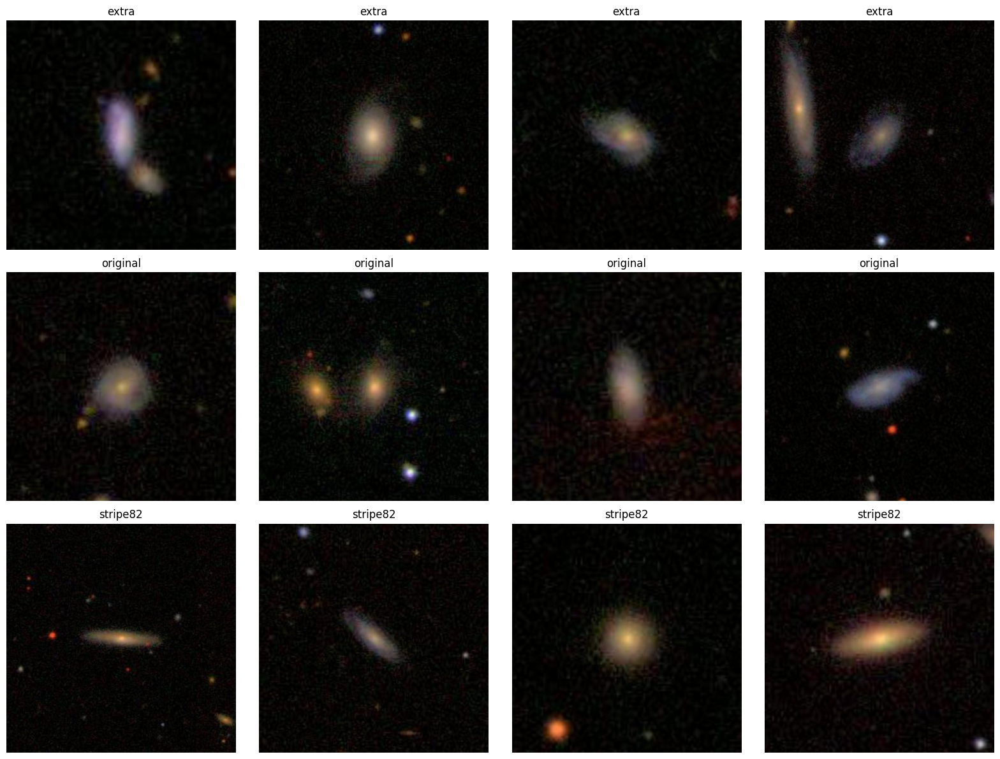

In [11]:
to_show_per_class = 4
to_show = (
    exploration_df_mapping.groupby("sample")
    .head(to_show_per_class)["sample"]
    .sort_values()
)

small_exploration_df_mapping = exploration_df_mapping.iloc[to_show.index, :]
small_exploration_df_mapping.reset_index(drop=True, inplace=True)
small_exploration_df = exploration_df[to_show.index]

show_images(small_exploration_df, small_exploration_df_mapping["sample"])

### RGB representation

In [12]:
classes = small_exploration_df_mapping["sample"].unique()

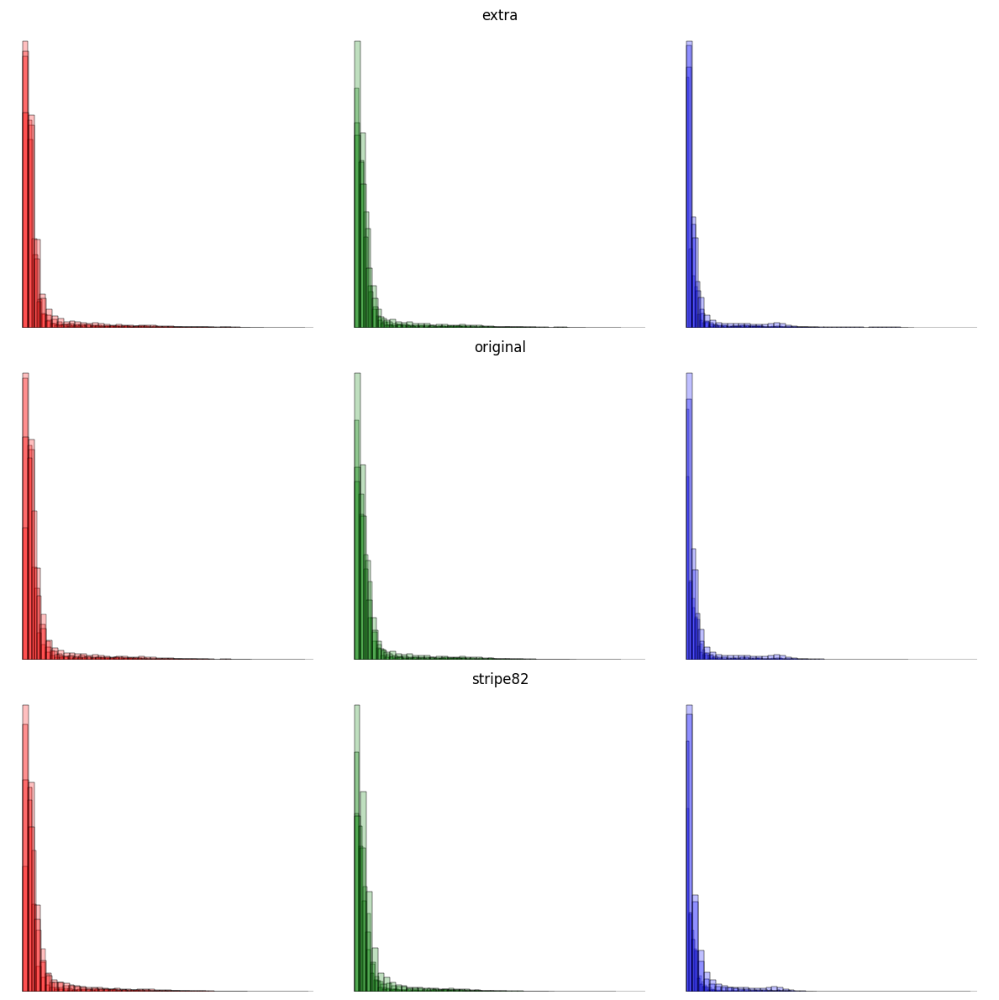

In [13]:
show_pixels(small_exploration_df, 4, len(classes), classes)

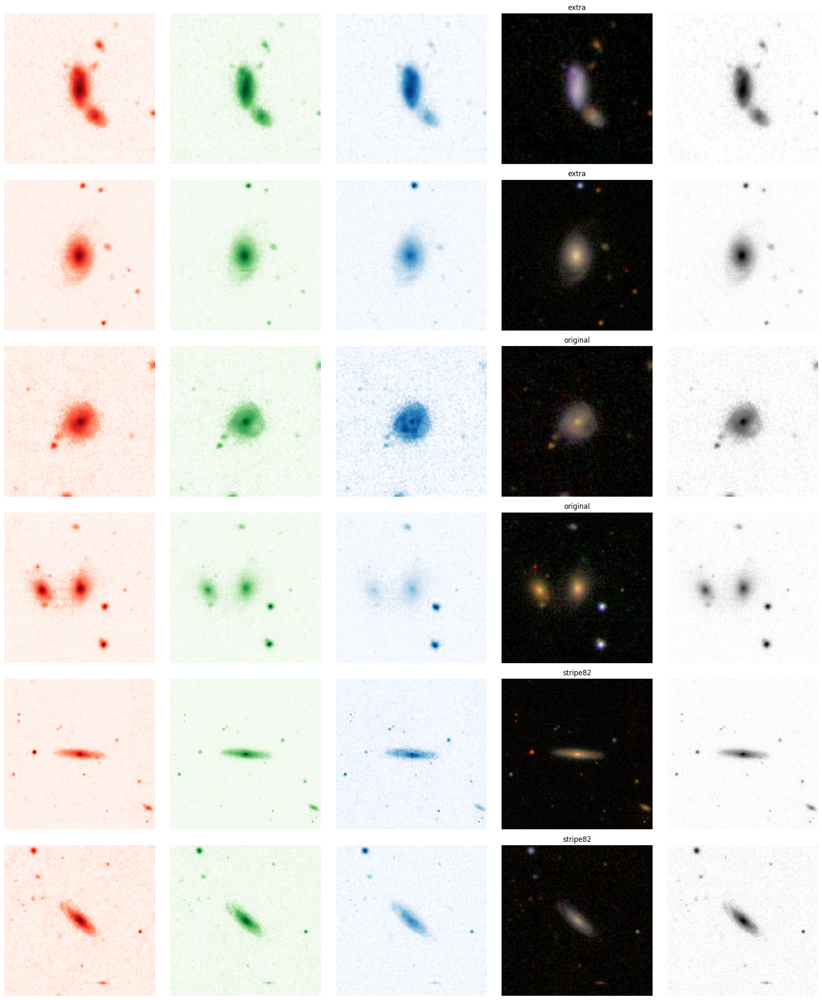

In [14]:
to_show = small_exploration_df_mapping.groupby("sample").head(2)["sample"].sort_values()

show_images_layers(small_exploration_df[to_show.index], to_show.values)

## Denoising

In our case we are dealing with images that have some noise. Noise reduction algorithms can selectively preserve important image details while removing noise. This helps to maintain critical features of the image, such as edges and textures, resulting in sharper and more detailed images. With that we improve the accuracy of image processing tasks such as object detection, classification, segmentation, and feature extraction, which we will need in our clusterisation problem.

In [15]:
denoise = lambda img: [
    img,
    # https://en.wikipedia.org/wiki/Total_variation_denoising
    denoise_tv_chambolle(img, weight=0.4, channel_axis=-1),
    denoise_tv_chambolle(img, weight=0.8, channel_axis=-1),
    # uses bilateral filter
    denoise_bilateral(img, sigma_color=0.1, sigma_spatial=5, channel_axis=-1),
    denoise_bilateral(img, sigma_color=0.2, sigma_spatial=15, channel_axis=-1),
    # https://en.wikipedia.org/wiki/Wavelet_transform
    denoise_wavelet(img, channel_axis=-1, rescale_sigma=True),
    denoise_wavelet(img, channel_axis=-1, convert2ycbcr=True, rescale_sigma=True),
    # http://www.ipol.im/pub/art/2011/bcm_nlm/article.pdf
    cv2.fastNlMeansDenoisingColored(
        img.astype(np.uint8), h=20, hColor=30, templateWindowSize=7, searchWindowSize=21
    ),
]
labels = [
    "noise",
    "tv_chambolle",
    "tv_chambolle stronger",
    "bilateral",
    "bilateral stronger",
    "wavelet",
    "wavelet (YCbCr colorspace)",
    "fastNlMeans",
]


def demonstrate_denoisers(img):
    denoised = denoise(img)
    for img, label in zip(denoised, labels):
        sigma_est = estimate_sigma(img, channel_axis=-1, average_sigmas=True)
        print(
            f"Estimated Gaussian noise standard deviation for '{label}' = {sigma_est}"
        )
    show_images_layers(denoised, labels, gray_=False)

Estimated Gaussian noise standard deviation for 'noise' = 0.36237426156087604
Estimated Gaussian noise standard deviation for 'tv_chambolle' = 1.4472232392419312e-05
Estimated Gaussian noise standard deviation for 'tv_chambolle stronger' = 2.290374589494114e-05
Estimated Gaussian noise standard deviation for 'bilateral' = 1.0744899457757764e-05
Estimated Gaussian noise standard deviation for 'bilateral stronger' = 9.68753918626633e-07
Estimated Gaussian noise standard deviation for 'wavelet' = 0.0009568390186172482
Estimated Gaussian noise standard deviation for 'wavelet (YCbCr colorspace)' = 0.0011258603680704034
Estimated Gaussian noise standard deviation for 'fastNlMeans' = 0.1770489842476726


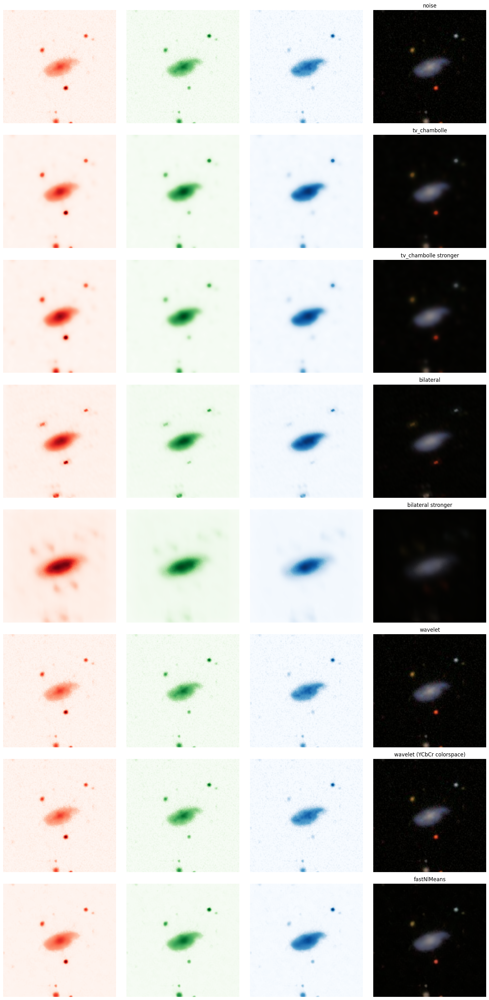

In [16]:
img = small_exploration_df[7]
demonstrate_denoisers(img)

**Conclusion:**
All of these deniosing algorithms are relatively slow and yield great data reduction. In our case (high res images in great volume) we will preceed straight forward to the clustering supported by deep learning models used as preprocessing of images, thus it allows us not only to greatly reduce data dimensionality before feeding it to clustering algorithms, but also to extract features that are not easily extracted by traditional methods and avoid the neccesity to deal with the noise. If any of denoising algorithms will be used, it will be used as a preprocessing step for the deep learning model and it'd be fastNlMeans based on above results.

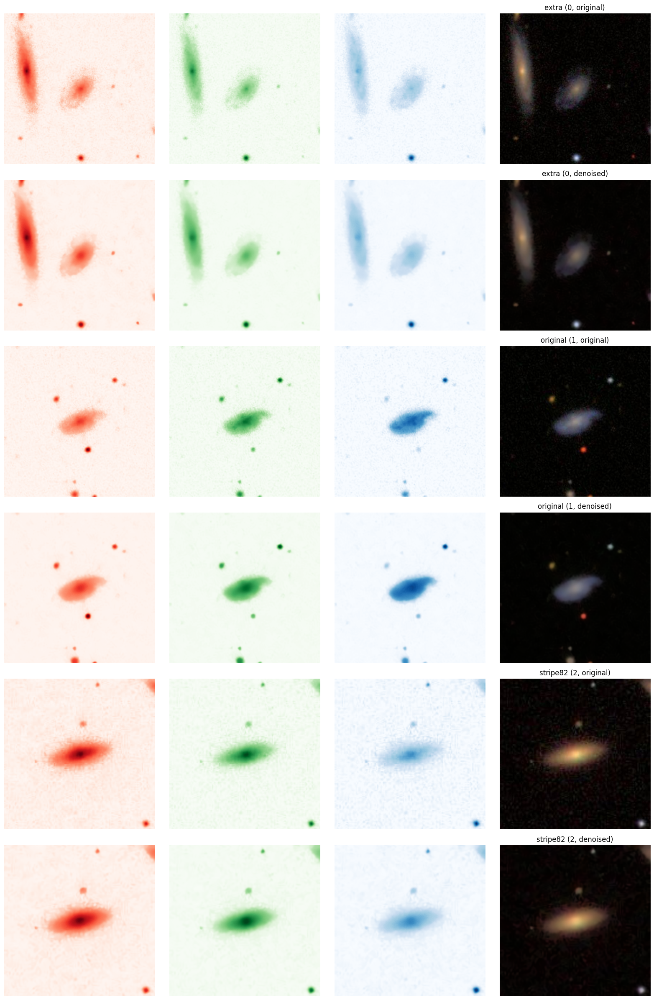

In [17]:
denoiser = lambda img: cv2.fastNlMeansDenoisingColored(
    img.astype(np.uint8), h=20, hColor=30, templateWindowSize=7, searchWindowSize=21
)

to_show = small_exploration_df_mapping.groupby("sample").tail(1)["sample"].sort_values()

denoised = []
names = []
for i, (image, name) in enumerate(
    zip(small_exploration_df[to_show.index], to_show.values)
):
    denoised.append(image)
    names.append(f"{name} ({i}, original)")
    denoised.append(denoiser(image))
    names.append(f"{name} ({i}, denoised)")

show_images_layers(denoised, names, gray_=False)

## Resizing the image

Resizing the image will be very important, as we want to improve the effectiveness.

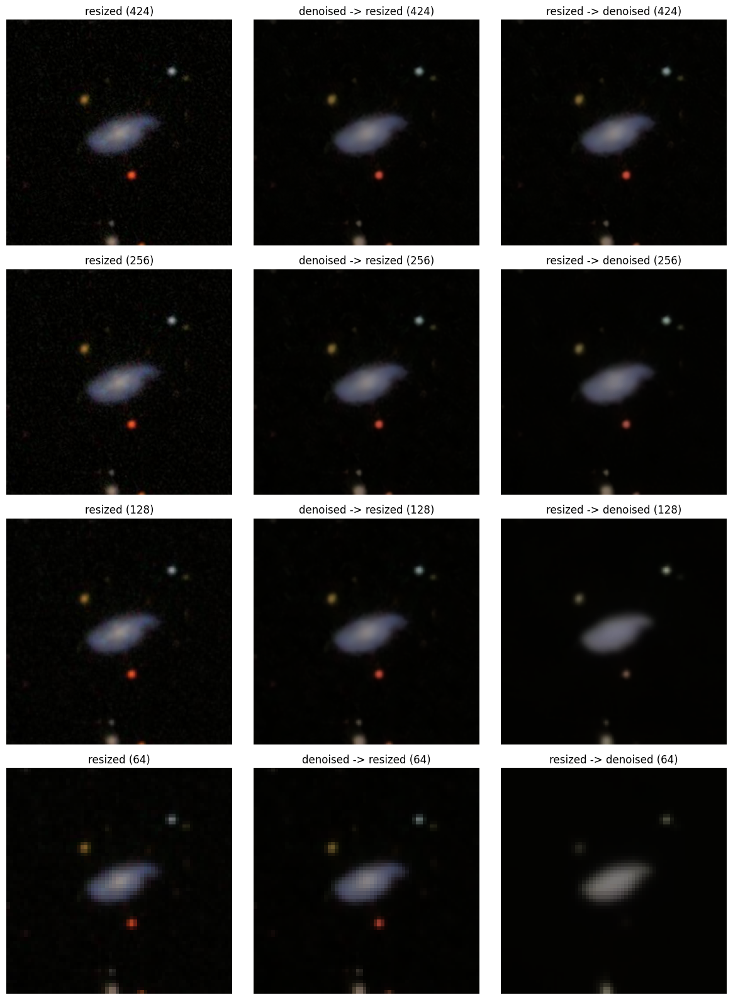

In [18]:
images = []
labels = []
sizes = [424, 256, 128, 64]

img_denoised = denoiser(img)
for size in sizes:
    resized = transform.resize(img, (size, size))
    images.append(resized)
    images.append(transform.resize(img_denoised, (size, size)))
    images.append(denoiser(resized * 255))
    labels += [
        f"resized ({size})",
        f"denoised -> resized ({size})",
        f"resized -> denoised ({size})",
    ]

show_images(images, labels, ncols=3)

We can see that even with rescaling we may still see the most important features of the image. Another idea is to crop the image. We know that all the galaxies are centered so we may implement an algorithm that will crop out the unimportant black background. 

# More sophisticated methods

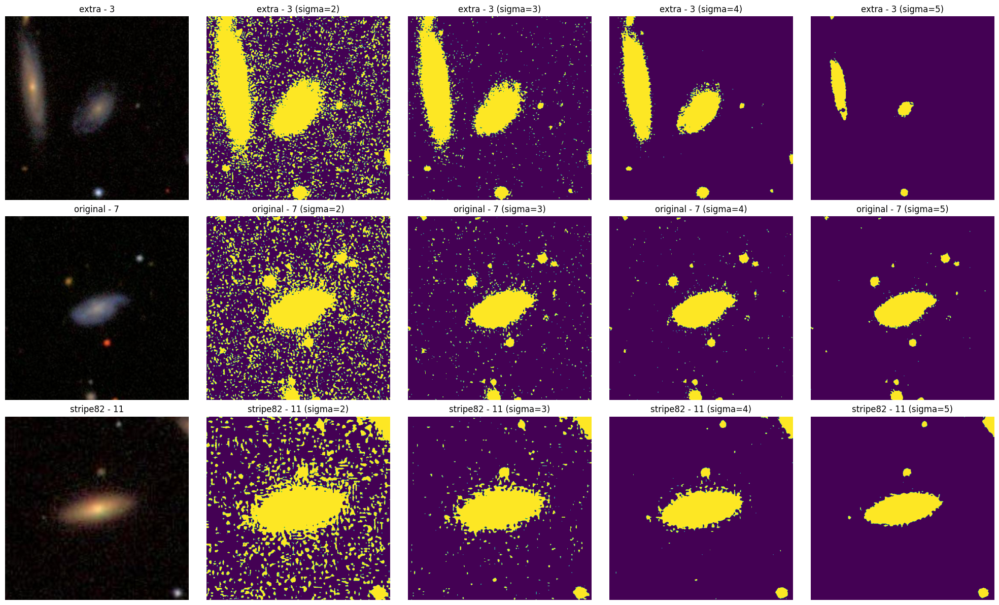

In [19]:
images = []
names = []
for i, (image, name) in enumerate(
    zip(small_exploration_df[to_show.index], to_show.values)
):
    images.append(image)
    names.append(f"{name} - {to_show.index[i]}")

    for sigma in (2, 3, 4, 5):
        images.append(get_binary_image(image.copy(), sigma=sigma))
        names.append(f"{name} - {to_show.index[i]} (sigma={sigma})")

show_images(images, names, ncols=5)

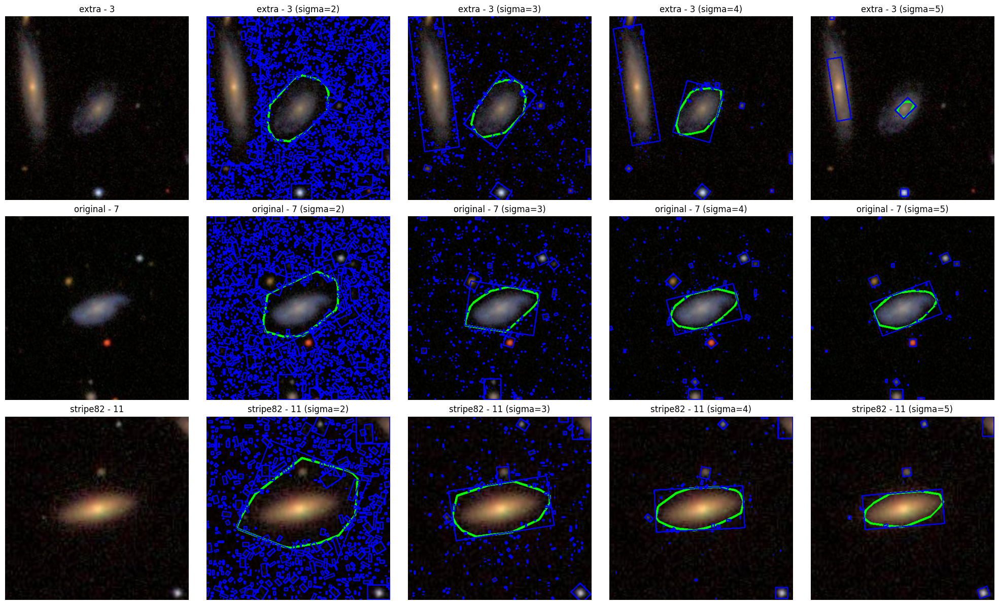

In [20]:
images = []
names = []
for i, (image, name) in enumerate(
    zip(small_exploration_df[to_show.index], to_show.values)
):
    images.append(image)
    names.append(f"{name} - {to_show.index[i]}")

    for sigma in (2, 3, 4, 5):
        images.append(get_boxes(image.copy(), sigma=sigma))
        names.append(f"{name} - {to_show.index[i]} (sigma={sigma})")

show_images(images, names, ncols=5)

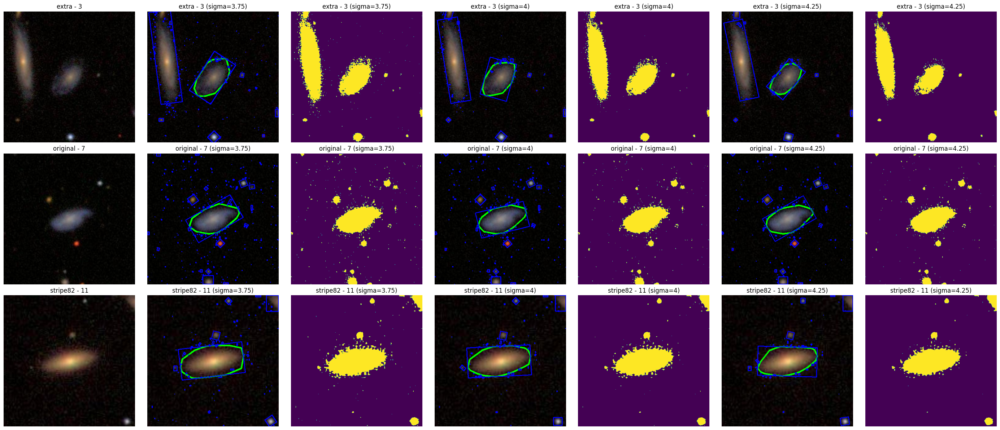

In [21]:
images = []
names = []
for i, (image, name) in enumerate(
    zip(small_exploration_df[to_show.index], to_show.values)
):
    images.append(image)
    names.append(f"{name} - {to_show.index[i]}")

    for sigma in (3.75, 4, 4.25):
        images.append(get_boxes(image.copy(), sigma=sigma))
        names.append(f"{name} - {to_show.index[i]} (sigma={sigma})")
        images.append(get_binary_image(image.copy(), sigma=sigma))
        names.append(f"{name} - {to_show.index[i]} (sigma={sigma})")

show_images(images, names, ncols=7)

Above charts presents search for other possible sigma values, yet 4 sigma rule seems to be the best one. Sigma = 5 leaves not enough information about the image, while sigma = 1 leaves too much noise. Sigma 3 yelds promising results, but it disallows for exxtraction of crowded regions.

In [22]:
for sigma in (2, 3, 3.75, 4, 4.25, 5):
    sizes = np.array([preprocess_image(image, sigma=sigma, return_size=True) for image in exploration_df])
    print(f"Sigma = {sigma}: {sizes.mean(axis=0)}, {sizes.std(axis=0)}")

Sigma = 2: [229.07333333 229.29333333], [56.82107551 57.14088398]
Sigma = 3: [174.40833333 174.335     ], [41.99851105 41.97597855]
Sigma = 3.75: [154.75166667 154.72      ], [35.72823343 35.69208502]
Sigma = 4: [148.395      148.36333333], [35.02702254 35.03485867]
Sigma = 4.25: [143.11333333 143.14666667], [34.96398846 34.97153827]
Sigma = 5: [125.76666667 125.80333333], [34.90838804 34.90999841]


Based on above results we will resize result images to 150x150 pixels.

So lets sum up how we preprocess the images up to now:
1. We cast image to grayscale and to this image we apply 4 sigma rule to calculate threshold that will be used to cast it to binary image.
2. On binary image we search for the appropriate contour and crop the image to the smallest rectangle that contains the contour. All data outside the contour is set to 0 (black) - presumed to be unimportant.
3. We enlarge the contour to be as close to square as possible, thus in above experiment on 10k images from training set mean of the bboxes sizes was close 150x150 pixeles. This will allow us to maintain the aspect.
4. We resize the image to 150x150 pixeles.

It's worth pointing out that we tested image sizes before contour enlargement and it turned out that the mean sizes of both dimensions were close, thus we've decided to continue with the square shape.

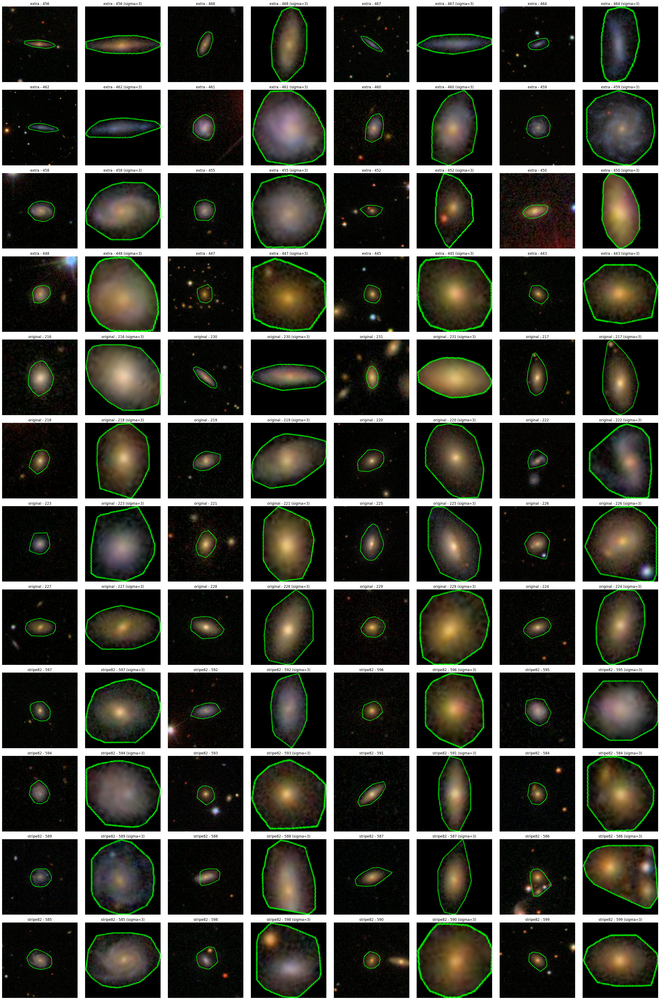

In [23]:
to_show = exploration_df_mapping.groupby("sample").tail(16)["sample"].sort_values()

images = []
names = []
for i, (image, name) in enumerate(
    zip(exploration_df[to_show.index], to_show.values)
):
    images.append(image)
    names.append(f"{name} - {to_show.index[i]}")
    images.append(preprocess_image(image, sigma=4, target_size=(150, 150), plot=True))
    names.append(f"{name} - {to_show.index[i]} (sigma=3)")

show_images(images, names, ncols=8)

Even tho in most cases this approach was sufficient, we discovered that in some cases where image is well centered and contains just the galaxy 4sigma rule treats most of the galaxy as noise. Therefore we added additional condition based on earlier calculations - if the bounding box is smaller than 100x100 pixels we will enlarge it to 200x200 pixels treating this as earlier mentioned error - here angle will be set to 0 as well and the image will be centered.

Below chart presents old vs new solution - green dot in most right column presents centroid of found best countour.

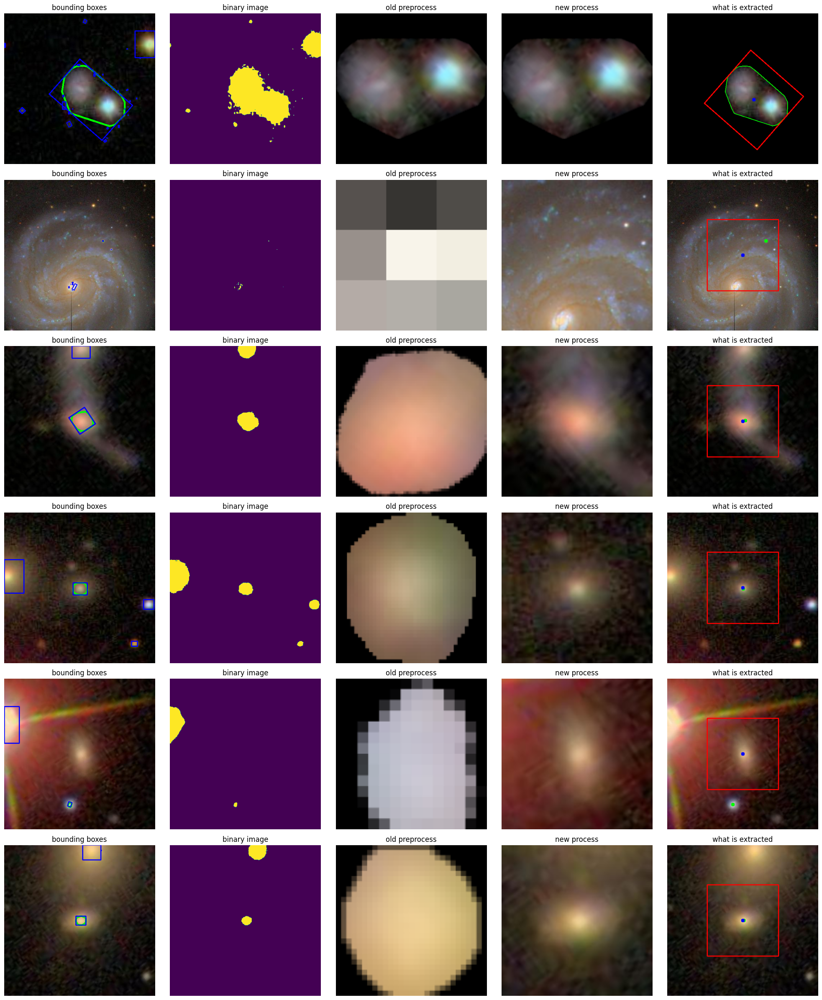

In [24]:
images = []
names = []
for image in load_images([f"../data/galaxy_zoo/{img}.jpg" for img in [91421, 82289, 87932, 92754, 95273, 101022]]):

    images.append(get_boxes(image.copy(), sigma=4))
    names.append(f"bounding boxes")
    images.append(get_binary_image(image.copy(), sigma=4))
    names.append(f"binary image")
    images.append(preprocess_image(image.copy(), sigma=4, target_size=(150, 150)))
    names.append(f"old preprocess")
    images.append(preprocess_image_2(image.copy(), sigma=4, target_size=(150, 150)))
    names.append(f"new process")
    images.append(preprocess_image_2(image.copy(), sigma=4, target_size=(150, 150), plot=True, plot_box=True))
    names.append(f"what is extracted")

show_images(images, names, ncols=5)

In [25]:
sizes = np.array([preprocess_image_2(image, sigma=4, return_size=True) for image in exploration_df])
print(f"Sigma = {sigma}: {sizes.mean(axis=0)}, {sizes.std(axis=0)}")

Sigma = 5: [153.50333333 153.46666667], [32.41717635 32.43792362]
